###Image Recognition Setup
#####Dataset/Input:   
- Doug's dataset from https://drive.google.com/open?id=0BwWNqvBKi6uTWFhtT0RpRGJWSEE at Oct 11th (9:12am PST)  
- Data from that link is expanded and saved as "dataset" folder with "feeds.json" and "train.csv" in it. 
- Also, must have created "images" folder inside "dataset" folder
- We only need to use "feeds.json" for this exercise.

####Model: 
- Basic pre-trained CaffeNet model

#####Starting this iPython Notebook: 
- Assume to be running at '/root' folder with following command:  

   *ipython notebook --profile=nbserver*

####Output:  
- Top 5 recognized objects for each image

In [1]:
#double-check ipython starting directory. Should be "/root"
!pwd

/root/ipython_notebooks


In [2]:
#clean up existing images within folder
!rm ../dataset/images/*

In [3]:
#Grab new images
import ast
import os
import json
import urllib
import posixpath
import urlparse 
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
%matplotlib inline

index=0
num_images=100 #number of images to analyze
with open('../dataset/feeds.json','r') as f:
    for line in f:
        
        post = json.loads(line)
#         _id = post["_id"]

        #read json but need to handle index error as certain lines of JSON has errors
        #during as we attempt to extract the value in image_url
        try:
            image_url = post['feed'][0]['images']['standard_resolution']
            #figure out filename
            path = urlparse.urlsplit(image_url).path
            filename = posixpath.basename(path)
            image_path = '../dataset/images/'+filename
            #download to local folder and resize image
            urllib.urlretrieve(image_url,image_path)
            
            #need to handle potential error due to issues not being able to open image file
            try: 
                img = Image.open(image_path)
                img.thumbnail((256,256),Image.ANTIALIAS) #best quality
                #set limit on number of images to process
                index+=1
                print "file no.",index,"processed:",image_path
                if index==num_images: break
            except IOError:
                print "Cannot open image: remove image and go to next line of JSON"
                os.remove(image_path)
            
        except IndexError:
            print "Index error with line of JSON: ignore and go to next line of JSON"


file no. 1 processed: ../dataset/images/10818008_1209542492396104_1144503542_n.jpg
file no. 2 processed: ../dataset/images/11899529_409336062593154_26859144_n.jpg
file no. 3 processed: ../dataset/images/12139791_172476163092798_682238343_n.jpg
file no. 4 processed: ../dataset/images/12081300_1628859394063453_635615121_n.jpg
file no. 5 processed: ../dataset/images/10817841_600978336707993_2134871113_n.jpg
file no. 6 processed: ../dataset/images/11377801_146811182334693_2053033951_n.jpg
file no. 7 processed: ../dataset/images/11917874_430458160477802_1119943501_n.jpg
file no. 8 processed: ../dataset/images/10919675_339630669566407_1560505453_n.jpg
file no. 9 processed: ../dataset/images/12071132_117024925320109_1448778029_n.jpg
file no. 10 processed: ../dataset/images/12135220_1490330321294598_1513851159_n.jpg
Cannot open image: remove image and go to next line of JSON
file no. 11 processed: ../dataset/images/12144312_512675712248774_150200782_n.jpg
file no. 12 processed: ../dataset/imag

Import required modules, set plotting parameters, and run ./scripts/download_model_binary.py models/bvlc_reference_caffenet to get the pretrained CaffeNet model if it hasn't already been fetched.

In [4]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# Make sure that caffe is on the python path:
caffe_root = '../caffe/'  # this file is expected to be in {caffe_root}/examples
import sys
sys.path.insert(0, caffe_root + 'python')

import caffe

plt.rcParams['figure.figsize'] = (10, 10)
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

import os
if not os.path.isfile(caffe_root + 'models/finetune_flickr_style/finetune_flickr_style.caffemodel'):
    print("Downloading pre-trained Flickr Style model...")
    !../caffe/scripts/download_model_binary.py ../caffe/models/bvlc_reference_caffenet

Set Caffe to CPU mode, load the net in the test phase for inference, and configure input preprocessing.

In [5]:
caffe.set_mode_cpu()
net = caffe.Net(caffe_root + 'models/finetune_flickr_style/deploy.prototxt',
                caffe_root + 'models/finetune_flickr_style/finetune_flickr_style.caffemodel',
                caffe.TEST)

# input preprocessing: 'data' is the name of the input blob == net.inputs[0]
transformer = caffe.io.Transformer({'data': net.blobs['data'].data.shape})
transformer.set_transpose('data', (2,0,1))
transformer.set_mean('data', np.load(caffe_root + 'python/caffe/imagenet/ilsvrc_2012_mean.npy').mean(1).mean(1)) # mean pixel
transformer.set_raw_scale('data', 255)  # the reference model operates on images in [0,255] range instead of [0,1]
transformer.set_channel_swap('data', (2,1,0))  # the reference model has channels in BGR order instead of RGB

In [6]:
# # GPU mode  (NEEED SPIN UP GPU FOR THIS)
# caffe.set_device(0)
# caffe.set_mode_gpu()
# net.forward()  # call once for allocation
# %timeit net.forward()

Make image predictions

In [11]:
from os import walk
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from math import ceil
%matplotlib inline

# set net to batch size to be the total number of images
net.blobs['data'].reshape(num_images,3,227,227)

# load labels
imagenet_labels_filename = caffe_root + 'examples/finetune_flickr_style/style_names.txt'
try:
    labels = np.loadtxt(imagenet_labels_filename, str, delimiter='\t')
except:
    !../data/ilsvrc12/get_ilsvrc_aux.sh
    labels = np.loadtxt(imagenet_labels_filename, str, delimiter='\t')

# load image data into model
for (dirpath, dirnames, filenames) in walk('../dataset/images/'):
    for i,filename in enumerate(filenames):        
        #load image into caffe preprocessor
        net.blobs['data'].data[i] = transformer.preprocess('data',  
            caffe.io.load_image('../dataset/images/'+filename))

#batch computation step (show computation time)
net.forward()  # call once for allocation
%timeit net.forward()

1 loops, best of 3: 7.94 s per loop


Create the plots of the final results

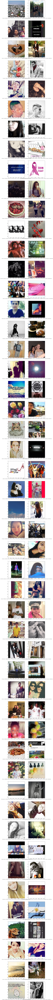

In [27]:
#parameters for creating subplots
num_rows=ceil(float(num_images)/2)
num_cols=2
plt.figure(figsize=(15,num_rows*8))

#display result, showing top 5 prediction for each image
for (dirpath, dirnames, filenames) in walk('../dataset/images/'):
    for i,filename in enumerate(filenames):
        top_k = net.blobs['prob'].data[i].flatten().argsort()[-1:-6:-1]
        top_predictions = labels[top_k]
        top_probs = sort(net.blobs['prob'].data[i].flatten())[-1:-6:-1]
    
        #creating the subplots of image with predictions as xlabel
        ax = plt.subplot(num_rows,num_cols,i+1)
        img = Image.open('../dataset/images/'+filename)
        ax.imshow(np.asarray(img))
        plt.xlabel(zip(top_predictions, top_probs))

#output the results
plt.show()